In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import palletes

plt.rcParams['agg.path.chunksize'] = 10000

rng = np.random.default_rng()

degree = np.pi/180
img_count = 0

In [2]:
def ease_cubic(t):

    if t <= 0:
        return 0
    elif t <= 0.5:
        return 4*t*t*t
    elif t <= 1:
        return 1 - (2-2*x)*(2-2*x)*(2-2*x)
    else:
        return 1

def cubic_bump(t, normalize=True):

    if normalize:
        norm = 16.0/7
    else:
        norm = 1

    if t <= 0:
        return 0
    elif t <= 0.5:
        return norm*ease_cubic(2*t)
    elif t <= 1:
        return norm*ease_cubic(2- 2*t)
    else:
        return 0

    

In [8]:
def rotmat(theta):
    '''
    Returns a matrix that rotates by theta counterclockwise.
    '''
    return np.array([[np.cos(theta),-np.sin(theta)],[np.sin(theta),np.cos(theta)]])

def unit_vector(angle):
    return np.array([np.cos(angle),np.sin(angle)])

    
def rotate_vector(vector,angle):
    return np.dot(rotmat(angle),vector)

def get_angle(v1,v2):
    if (v1==v2).all():
        return 0
    elif (v1 == -v2).all():
        return np.pi
    else:
        return np.arccos(np.dot(v1,v2)/np.sqrt(np.dot(v1,v1)*np.dot(v2,v2)))

def reflect(vector,normal):

    normal = normal/np.sqrt(np.dot(normal,normal))

    return 2*np.dot(vector,normal)*normal - vector


In [88]:
class Ray:

    def __init__(self,base,direction, endpoint = None):
        self.base = base
        self.direction = direction
        self.endpoint = endpoint


    def find_endpoint(self):
        '''
        Gets the endpoint of the ray assuming the ray spans a chord in a circle
        '''

        endpoint_time = -2*np.dot(self.direction,self.base)
        self.endpoint = self.base + endpoint_time*self.direction
    

    def rotate(self,angle):
        '''
        Rotate the direction of the ray while keeping the basepoint fixed.
        '''
        self.direction = rotate_vector(self.direction,angle)
        self.find_endpoint()

    def bounce(self):
        
        if self.endpoint is None:
            self.find_endpoint()
        
        refl_direction = reflect(-self.direction,self.endpoint)

        return Ray(self.endpoint,refl_direction)   

    def clone(self):

        return Ray(self.base[:],self.direction[:],self.endpoint)

    def get_sine(self,harmonic=10,amplitude=0.1,n_points=500):

        if self.endpoint is None:
            self.find_endpoint()

        chord_length = np.sqrt(np.dot(self.base-self.endpoint,self.base-self.endpoint))
        if chord_length<=1e-8:
            return np.array([[self.base[0]],[self.base[1]]])

        Ts = np.linspace(0,chord_length,n_points)
        perp = rotate_vector(self.direction,np.pi/2)
        sign = rng.choice([-1,1])
        curve_x = Ts*self.direction[0] + sign*amplitude*np.sin(harmonic*np.pi/chord_length * Ts)*perp[0] + self.base[0]
        curve_y = Ts*self.direction[1] + sign*amplitude*np.sin(harmonic*np.pi/chord_length * Ts)*perp[1] + self.base[1]
        return np.array([curve_x,curve_y])


In [85]:
radius = 1

n_bounces = 4

n_spread = 7

angle_spread = 2*degree

init_angle = 45*(2*rng.random()-1)*degree
init_dir = unit_vector(init_angle)

init_base = np.array([-1,0])

rays = [ [Ray(init_base,init_dir)] ]


for i in range(n_bounces):

    new_rays = []
    print("Number of rays:",len(rays[i]))
    for ray in rays[i]:
        
        angle_deltas = angle_spread*(2*rng.random(n_spread) - 1)

        for delta in angle_deltas:

            new_ray = ray.bounce()
            new_ray.rotate(delta)

            if np.dot(new_ray.direction,new_ray.base)<=0:
                new_rays.append(new_ray)

    rays.append(new_rays)


Number of rays: 1
Number of rays: 7
Number of rays: 49
Number of rays: 343


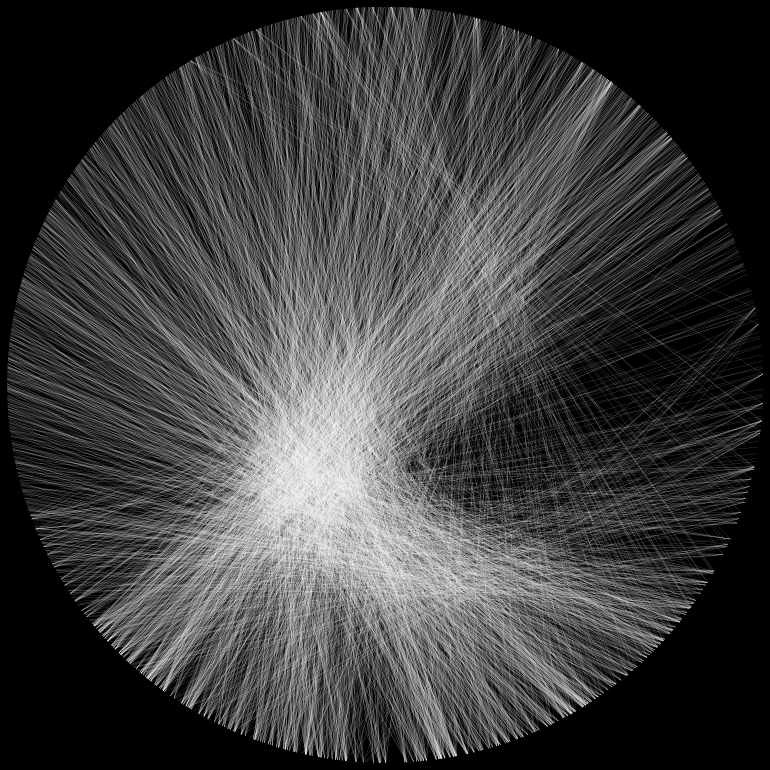

In [69]:
background_color = 'k'
pallete = palletes.ice_cream_shop

fig, ax = plt.subplots(figsize=(10.8,10.8))

for idx,wave in enumerate(rays):

    alpha = 1
    color = rng.choice(pallete)
    for ray in wave:
        ax.plot([ray.base[0],ray.endpoint[0]],[ray.base[1],ray.endpoint[1]],color='w',lw=0.1)

ax.axis('off')
ax.set_xlim(-1,1)
ax.set_ylim(-1,1)
ax.set_facecolor(background_color)
fig.set_facecolor(background_color)
fig.tight_layout()
fig.savefig('images/caustics_%02d.png'%img_count,dpi=200,bbox_inches='tight',pad_inches=0)
img_count = img_count + 1
plt.show()

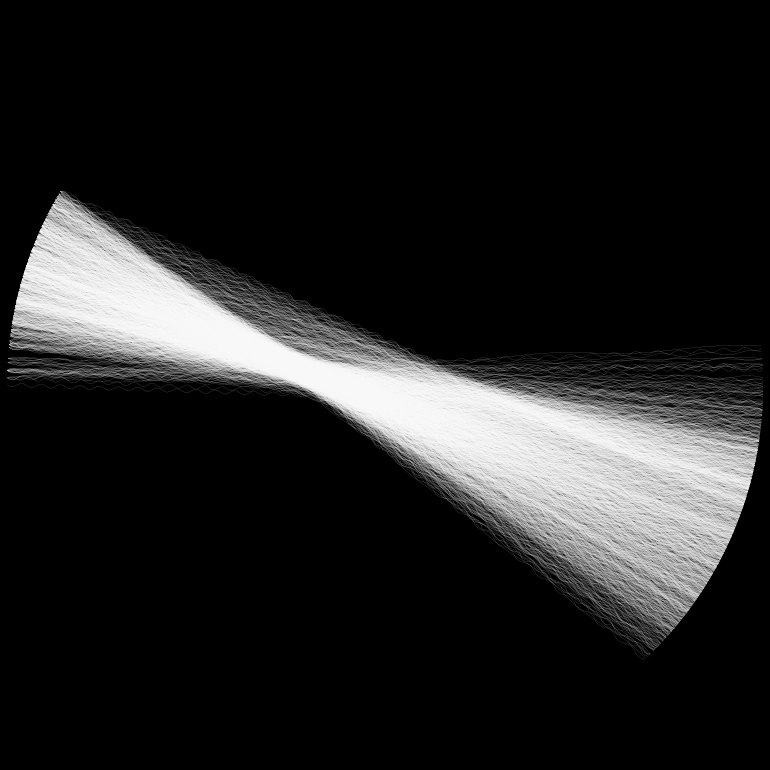

In [89]:
fig, ax = plt.subplots(figsize=(10.8,10.8))

for idx,wave in enumerate(rays):

    alpha = 1
    color = rng.choice(pallete)
    for ray in wave:
        harmonic = rng.integers(1,100)
        curve = ray.get_sine(harmonic=harmonic,amplitude=0.005)
        ax.plot(curve[0,:],curve[1,:],color='w',lw=0.1)

ax.axis('off')
ax.set_xlim(-1,1)
ax.set_ylim(-1,1)
ax.set_facecolor(background_color)
fig.set_facecolor(background_color)
fig.tight_layout()
fig.savefig('images/caustics_%02d.png'%img_count,dpi=200,bbox_inches='tight',pad_inches=0)
img_count = img_count + 1
plt.show()

In [108]:
n_points = 45

n_bounces = 3

n_spread = 10
angle_spread = 5*degree

init_points = [np.array([-np.sqrt(1-y*y),y]) for y in np.linspace(-1+0.01,1-0.01,n_points)]
init_rays = [Ray(base,np.array([1,0])) for base in init_points]

waves = [init_rays]

for i in range(n_bounces):
    new_rays = []

    print("Number of rays:",len(waves[i]))

    for ray in waves[i]:
        
        if i == 0:
            angle_deltas = angle_spread*(2*rng.random(n_spread) - 1)

            for delta in angle_deltas:

                new_ray = ray.bounce()
                new_ray.rotate(delta)

                if np.dot(new_ray.direction,new_ray.base)<=0:
                    new_rays.append(new_ray)
        else:

            delta = angle_spread*(2*rng.random()-1)
            new_ray = ray.bounce()
            new_ray.rotate(delta)
            
            if np.dot(new_ray.direction,new_ray.base)<=0:
                new_rays.append(new_ray)

    waves.append(new_rays)


Number of rays: 45
Number of rays: 450
Number of rays: 450


Wave: 0
	Number of rays 45
Wave: 1
	Number of rays 450
Wave: 2
	Number of rays 450
Wave: 3
	Number of rays 449


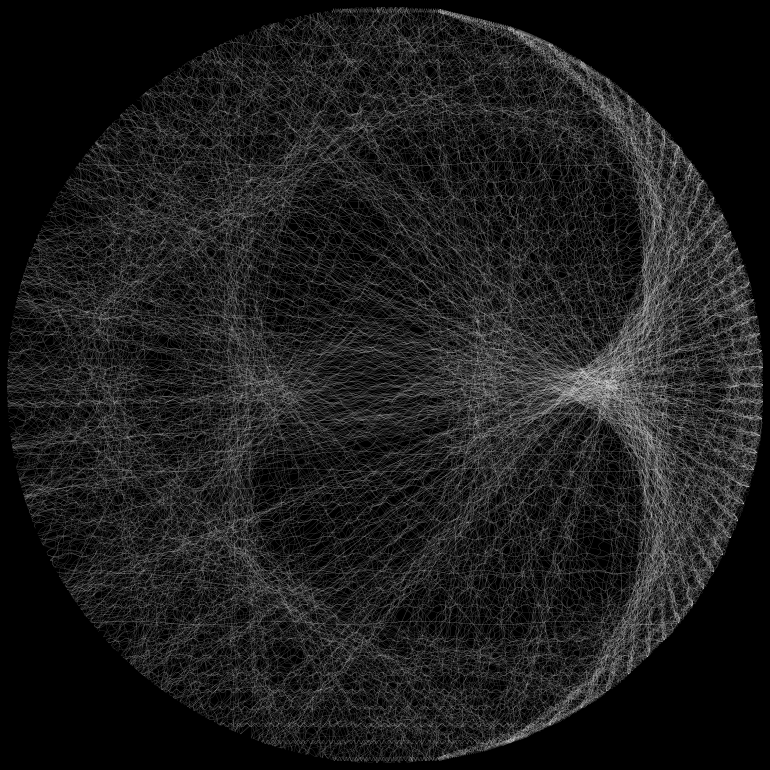

In [109]:
fig, ax = plt.subplots(figsize=(10.8,10.8))

amplitudes = [0.15,0.1,0.075,0.075]

for idx,wave in enumerate(waves):
    print("Wave:",idx)
    print("\tNumber of rays",len(wave))
    alpha = 1
    color = rng.choice(pallete)
    for ray in wave:
        harmonic = rng.integers(1,100)
        curve = ray.get_sine(harmonic=harmonic,amplitude=0.005)
        ax.plot(curve[0,:],curve[1,:],color='w',lw=amplitudes[idx])

ax.axis('off')
ax.set_xlim(-1,1)
ax.set_ylim(-1,1)
ax.set_facecolor(background_color)
fig.set_facecolor(background_color)
fig.tight_layout()
fig.savefig('images/caustics_%02d.png'%img_count,dpi=200,bbox_inches='tight',pad_inches=0)
img_count = img_count + 1
plt.show()